In [1]:
# imports
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms.transforms as tf
from torch.utils.tensorboard import SummaryWriter

import matplotlib.pyplot as plt
import numpy as np
import random
from PIL import Image

import math
import os
import time
from datetime import datetime
from tqdm.auto import tqdm
import imageio
import IPython
import Helpers
import uuid

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Hyperparameters

All the Hyperparameters are based on https://arxiv.org/abs/1511.06434

In [5]:
batch_size = 128
epochs = 500

weights_init_mean = 0.0
weights_init_stddev = 0.02

generator_lr = 2e-4
discriminator_lr = 2e-4
beta1 = 0.5
beta2 = 0.999

feature_scale = 64
n_image_channels = 3
image_size = 64
latent_dim = 100
log_interval = 30

log_dir = r"./logs"
save_dir = r"./models"
data_path = r"D:/CS/Datasets/flowers/"     # Dataset downloaded from https://www.kaggle.com/datasets/l3llff/flowers

model_name = f"Flower_Generator - {datetime.now().strftime('%Y%m%d-%H%M%S')}"

# Loading the Dataset

In [3]:
# Preprocessing
transforms = torchvision.transforms.transforms.Compose(
    [
        tf.Resize((image_size, image_size)),
        tf.ToTensor(),
        # Noramlize the pixels between [-1, 1]
        tf.Normalize([0.5 for channel in range(n_image_channels)],
                     [0.5 for channel in range(n_image_channels)])
    ]
)

# Load the dataset
#dataset = torchvision.datasets.MNIST(root="MNIST/", train=True, transform=transforms, download=True)      # For testing
dataset = torchvision.datasets.ImageFolder(root=data_path, transform=transforms)
data_loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Data Analysis

In [4]:
meta_data, n_classes = Helpers.Data_Helper.gen_metadata_from_directory(data_path)

  0%|          | 0/16 [00:00<?, ?it/s]

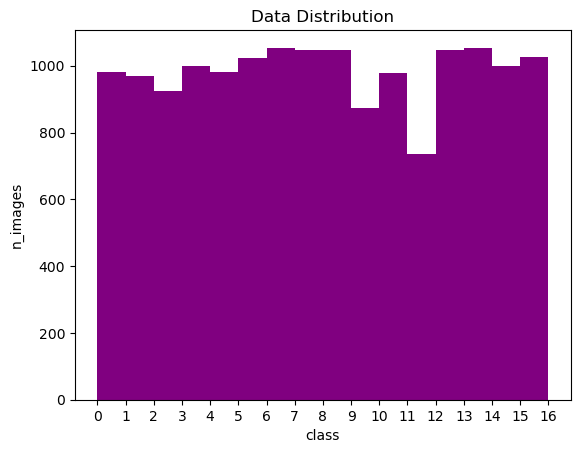

In [5]:
# Plot the histogram
plt.hist(meta_data.labels.to_numpy(),
         bins=np.arange(0, n_classes + 1),
         color='purple')
plt.xticks(ticks=np.arange(0, n_classes + 1), 
           labels=np.arange(0, n_classes + 1))

# Set the labels
plt.title("Data Distribution")
plt.xlabel("class")
plt.ylabel("n_images")

# Dislpay the plot
plt.show()

In [6]:
print(f"Number of samples in the dataset: {len(meta_data)}")

Number of samples in the dataset: 15740


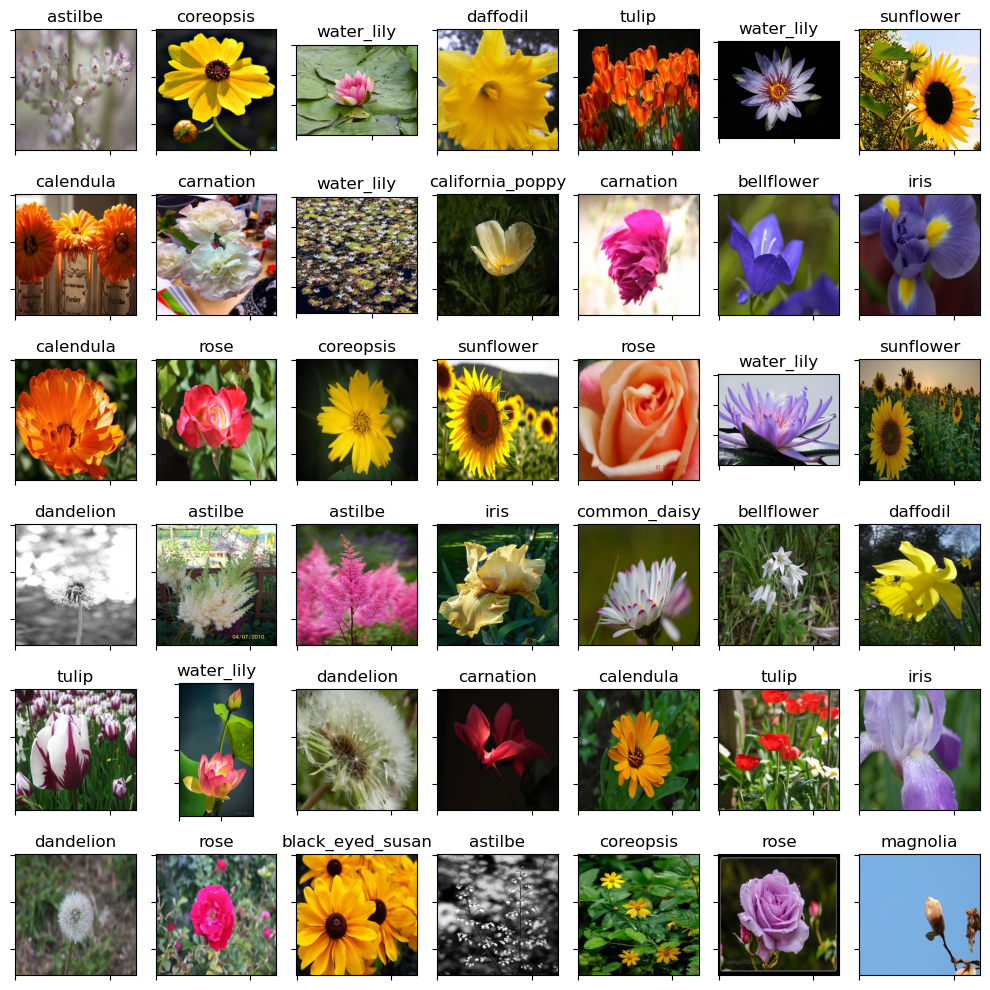

In [188]:
n_images_to_plot = 42

# Shuffle the dataframe
meta_data = meta_data.sample(frac=1).reset_index(drop=True)

# Randomly select images form the dataframe
start_index = random.randint(0, len(meta_data) - n_images_to_plot)

image_paths = meta_data.iloc[start_index: start_index + n_images_to_plot].image_paths.to_list()   
labels =  meta_data.iloc[start_index: start_index + n_images_to_plot].labels.to_list()   

# Load the images
images = [Helpers.Image_Helper.load_image(image_path) for image_path in image_paths]

# Plot the images
Helpers.Data_Helper.plot(images, labels, figSize=(10, 10))

# Creating the Generator & Discriminator

Network Architecture based on https://arxiv.org/abs/1511.06434

In [8]:
# Define the weight initializer
def weights_init(model):
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, weights_init_mean, weights_init_stddev)     # _ means inplace

In [3]:
# Define generator
class Generator(nn.Module):
    def __init__(self, latent_dim, n_image_channels, feature_scale=64):
        assert feature_scale % 2 == 0
        super(Generator, self).__init__()
        
        self.generator = nn.Sequential(
            # 1 x 1 => 4 x 4 
            nn.ConvTranspose2d(latent_dim, feature_scale * 16, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(feature_scale * 16),
            nn.ReLU(),
            
            # 4 x 4 => 8 x 8
            nn.ConvTranspose2d(feature_scale * 16, feature_scale * 8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_scale * 8),
            nn.ReLU(),
            
            # 8 x 8 => 16 x 16 
            nn.ConvTranspose2d(feature_scale * 8, feature_scale * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_scale * 4),
            nn.ReLU(),
            
            # 16 x 16 => 32 x 32
            nn.ConvTranspose2d(feature_scale * 4, feature_scale * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_scale * 2),
            nn.ReLU(),
            
            # 16 x 16 => 64 x 64
            nn.ConvTranspose2d(feature_scale * 2, n_image_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        ).to(device)
        
    def forward(self, x):
        return self.generator(x)

In [10]:
# Define discriminator
class Discriminator(nn.Module):
    def __init__(self, n_image_channels, feature_scale=64):
        super(Discriminator, self).__init__()
        
        self.discriminator = nn.Sequential(
            # 64 x 64 => 32 x 32
            nn.Conv2d(n_image_channels, feature_scale * 1, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            
            # 32 x 32 => 16 x 16
            nn.Conv2d(feature_scale * 1, feature_scale * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_scale * 2),
            nn.LeakyReLU(0.2),
            
            # 16 x 16 => 8 x 8
            nn.Conv2d(feature_scale * 2, feature_scale * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_scale * 4),
            nn.LeakyReLU(0.2),
            
            # 8 x 8 => 4 x 4
            nn.Conv2d(feature_scale * 4, feature_scale * 8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(feature_scale * 8),
            nn.LeakyReLU(0.2),
            
            # 4 x 4 => 1 x 1
            nn.Conv2d(feature_scale * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid(),
        ).to(device)
        
    def forward(self, x):
        return self.discriminator(x)

In [11]:
# Create the models
generator = Generator(latent_dim, n_image_channels, feature_scale).to(device)
discriminator = Discriminator(n_image_channels, feature_scale).to(device)

# Initialize the parameters
weights_init(generator)
weights_init(discriminator)

# Define the optimizers and loss
gen_opt = optim.Adam(generator.parameters(), lr=generator_lr, betas=(beta1, beta2))
disc_opt = optim.Adam(discriminator.parameters(), lr=discriminator_lr, betas=(beta1, beta2))
criterian = nn.BCELoss().to(device)

# Define the Tensorboard writers
fixed_noise = torch.randn((32, latent_dim, 1, 1)).to(device)
writer_real = SummaryWriter(os.path.join(log_dir, model_name, "real"))
writer_fake = SummaryWriter(os.path.join(log_dir, model_name, "fake"))
log_step = 0

# Switch to training mode
print(generator.train())
print(discriminator.train())

Generator(
  (generator): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): Tanh()
  )
)
Discriminator(
  (discriminator): Sequential(
   

# Train Loop

In [12]:
fake_grids = []

# Training loop
for epoch in tqdm(range(1, epochs + 1), desc="Total epochs", colour='purple'):
    for i , (batch, _) in tqdm(enumerate(data_loader), total=len(data_loader), desc=f"Epoch {epoch}"):
        # Generater forward pass
        noise = torch.randn((batch_size, latent_dim, 1, 1)).to(device)
        real_images = batch.to(device)
        fake_images = generator(noise)
        
        # Discriminator forwardpass
        real_yhat = discriminator(real_images).reshape(-1)
        fake_yhat = discriminator(fake_images.detach()).reshape(-1)
        
        # Calculate discriminator's loss
        disc_real_loss = criterian(real_yhat, torch.ones_like(real_yhat)).to(device)
        disc_fake_loss = criterian(fake_yhat, torch.zeros_like(fake_yhat)).to(device)
        disc_total_loss = (disc_real_loss + disc_fake_loss)
        
        # apply the discriminator's gradients
        discriminator.zero_grad()
        disc_total_loss.backward(retain_graph=True)
        disc_opt.step()
        
        # Calculate generator's los
        yhat = discriminator(fake_images)
        gen_total_loss = criterian(yhat, torch.ones_like(yhat)).to(device)
        
        # apply the generator's gradients
        generator.zero_grad()
        gen_total_loss.backward()
        gen_opt.step()
        
        # Logging
        tqdm.write(f"Generator_Loss: {gen_total_loss:.5f} - Discriminator_Loss: {disc_total_loss:.5f}", end='\r')
        
        if i % log_interval == 0:
            with torch.no_grad():
                # Generate new images
                generated_images = generator(fixed_noise)
                
                # Create a grid
                real_grid = torchvision.utils.make_grid(batch[:32], normalize=True)
                fake_grid = torchvision.utils.make_grid(generated_images[:32], normalize=True)
                
                # Append the generated images to a list (for creating a gif)
                fake_grid_converted = fake_grid.cpu().permute(1, 2, 0)                         # First we have to move the image to CPU and reshape it
                fake_grid_converted = np.array(fake_grid_converted * 255.0, dtype=np.uint8)
                fake_grids.append(fake_grid_converted)            
                
                # Log to Tensorboard
                writer_real.add_image("Real", real_grid, global_step=log_step)
                writer_fake.add_image("Fake", fake_grid, global_step=log_step)
                
                log_step += 1

# Save the model
torch.save(generator, os.path.join(save_dir, f"{model_name}.pt"))

Total epochs:   0%|          | 0/500 [00:00<?, ?it/s]

Epoch 1:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 2:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 3:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 4:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 5:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 6:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 7:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 8:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 9:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 10:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 11:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 12:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 13:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 14:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 15:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 16:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 17:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 18:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 19:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 20:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 21:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 22:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 23:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 24:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 25:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 26:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 27:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 28:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 29:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 30:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 31:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 32:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 33:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 34:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 35:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 36:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 37:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 38:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 39:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 40:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 41:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 42:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 43:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 44:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 45:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 46:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 47:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 48:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 49:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 50:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 51:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 52:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 53:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 54:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 55:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 56:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 57:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 58:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 59:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 60:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 61:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 62:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 63:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 64:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 65:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 66:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 67:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 68:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 69:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 70:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 71:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 72:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 73:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 74:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 75:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 76:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 77:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 78:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 79:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 80:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 81:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 82:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 83:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 84:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 85:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 86:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 87:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 88:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 89:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 90:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 91:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 92:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 93:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 94:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 95:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 96:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 97:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 98:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 99:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 100:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 101:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 102:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 103:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 104:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 105:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 106:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 107:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 108:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 109:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 110:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 111:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 112:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 113:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 114:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 115:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 116:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 117:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 118:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 119:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 120:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 121:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 122:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 123:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 124:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 125:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 126:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 127:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 128:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 129:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 130:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 131:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 132:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 133:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 134:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 135:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 136:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 137:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 138:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 139:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 140:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 141:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 142:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 143:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 144:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 145:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 146:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 147:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 148:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 149:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 150:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 151:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 152:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 153:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 154:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 155:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 156:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 157:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 158:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 159:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 160:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 161:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 162:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 163:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 164:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 165:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 166:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 167:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 168:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 169:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 170:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 171:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 172:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 173:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 174:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 175:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 176:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 177:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 178:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 179:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 180:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 181:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 182:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 183:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 184:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 185:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 186:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 187:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 188:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 189:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 190:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 191:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 192:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 193:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 194:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 195:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 196:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 197:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 198:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 199:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 200:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 201:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 202:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 203:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 204:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 205:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 206:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 207:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 208:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 209:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 210:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 211:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 212:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 213:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 214:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 215:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 216:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 217:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 218:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 219:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 220:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 221:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 222:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 223:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 224:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 225:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 226:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 227:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 228:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 229:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 230:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 231:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 232:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 233:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 234:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 235:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 236:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 237:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 238:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 239:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 240:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 241:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 242:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 243:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 244:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 245:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 246:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 247:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 248:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 249:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 250:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 251:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 252:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 253:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 254:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 255:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 256:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 257:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 258:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 259:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 260:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 261:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 262:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 263:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 264:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 265:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 266:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 267:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 268:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 269:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 270:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 271:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 272:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 273:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 274:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 275:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 276:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 277:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 278:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 279:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 280:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 281:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 282:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 283:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 284:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 285:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 286:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 287:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 288:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 289:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 290:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 291:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 292:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 293:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 294:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 295:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 296:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 297:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 298:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 299:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 300:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 301:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 302:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 303:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 304:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 305:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 306:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 307:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 308:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 309:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 310:   0%|          | 0/123 [00:00<?, ?it/s]

Epoch 311:   0%|          | 0/123 [00:00<?, ?it/s]

KeyboardInterrupt: 

# Model Evaluation

In [8]:
generator = torch.load(os.path.join(save_dir, f"{model_name}.pt"))

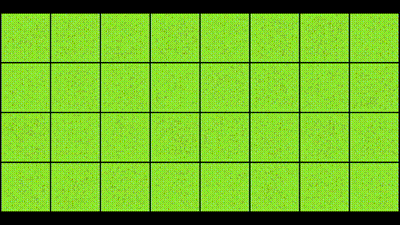

In [9]:
# Create and display a gif 
gif_dir = os.path.join(log_dir, f"{model_name} -- {str(uuid.uuid4())}.gif")

# Create the gif
imageio.mimsave(gif_dir, fake_grids, fps=50)

# Display the gif
IPython.display.Image(filename=gif_dir)

In [11]:
def generate_grid(n_images=1024, nrow=None, save=True, save_dir="./logs/images"):
    if nrow is None:
        nrow = int(math.sqrt(n_images))
        
    # Generator forward pass 
    noise = torch.randn(n_images, latent_dim, 1, 1)
    generator.to(torch.device('cpu'))
    generated_images = generator(noise)
    
    # Create a grid
    grid = torchvision.utils.make_grid(generated_images, normalize=True, nrow=nrow)
    
    # Reshape the grid
    grid = grid.permute(1, 2, 0)
    
    # Convert to np array
    grid = grid.numpy()
    
    # Scale pixel values from [0,1] to [0,255] and convert to uint8
    grid = (grid * 255).astype('uint8')
    
    # Create a PIL image from the numpy array
    img = Image.fromarray(grid)

    # Save the image as a JPEG
    if save:
        img.save(os.path.join(save_dir, f"generated_flowers -- {str(uuid.uuid4())}.jpg"),
                 format='JPEG')
    
    return grid

In [12]:
# Generate a 32 by 32 grid
grid = generate_grid(n_images=32 * 32)

# Plot the grid
fig = plt.figure(figsize=(100, 100))
plt.imshow(grid)
plt.show()